In [1]:
import Pkg
Pkg.add("DifferentialEquations")
Pkg.add("Turing")
Pkg.add("Distributions")
Pkg.add("StatsPlots")

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]


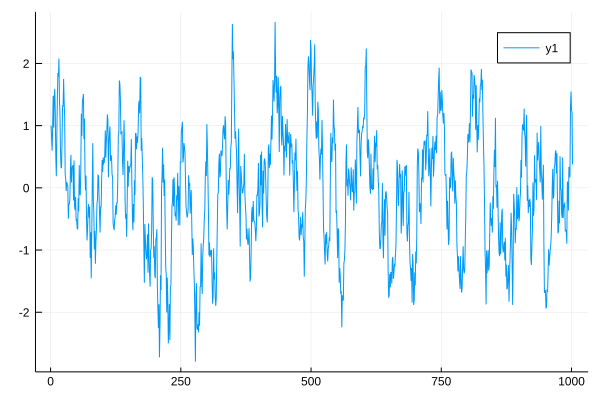

In [2]:
using DifferentialEquations
using Plots

μ = 0.0
σ = sqrt(2)
Θ = 1.0
W = OrnsteinUhlenbeckProcess(Θ,μ,σ,0.0,1.0)
prob = NoiseProblem(W,(0.0,100.0))
sol = solve(prob;dt=0.1)
plot(sol.u)

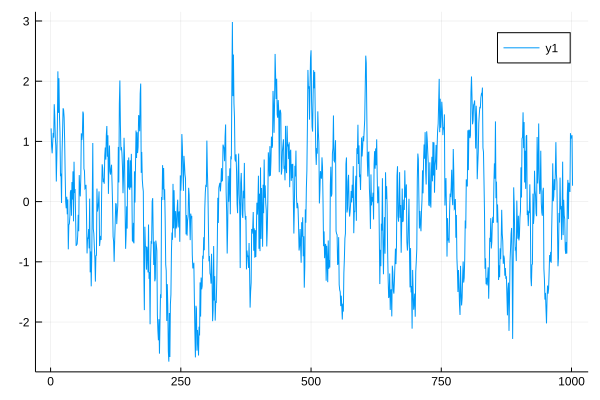

In [8]:
using Distributions, Random
ou_data = sol.u
noise = rand(Normal(0,0.2), length(ou_data))
plot(ou_data+noise)

In [13]:
using Turing
using Distributions

# Ornstein-Uhlenbeck process with added Gaussian noise
@model oupn(rn,T,delta_t=0.1) = begin
    ampl ~ Uniform(0.0,5.0)
    tau ~ Uniform(0.0,5.0)
    noise_ampl ~ Uniform(0.0,1)
    
    b = exp(-delta_t/tau)
    r = Vector(undef, T)
    
    r[1] ~ Normal(0,sqrt(ampl))
    rn[1] ~ Normal(r[1],sqrt(noise_ampl))
    
    for i=2:T
        r[i] ~ Normal(r[i-1]*b,sqrt(ampl*(1-b^2)))
        rn[i] ~ Normal(r[i],sqrt(noise_ampl))
    end
end

(::DynamicPPL.ModelGen{(:rn, :T, :delta_t),var"###oupn#628",NamedTuple{(:delta_t,),Tuple{Float64}}}) (generic function with 1 method)

In [14]:
using StatsPlots

chn = sample(oupn(ou_data+noise,length(ou_data),0.1), NUTS(0.8), 2000)

# Summarise results (currently requires the master branch from MCMCChains)
describe(chn)



┌ Info: Found initial step size
│   ϵ = 0.05
└ @ Turing.Inference /Users/hstrey/.julia/packages/Turing/vg86q/src/inference/hmc.jl:555
Sampling   0%|                               |  ETA: 10:46:29
  iteration:                     1
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               1.0
  log_density:                   -4444.2178424991735
  hamiltonian_energy:            5279.148542808366
  hamiltonian_energy_error:      -125.75743825268819
  max_hamiltonian_energy_error:  -125.75743825268819
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.05
  nom_step_size:                 0.05
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   0%|                               |  ETA: 5:41:45
  iteration:                     2
  n_steps:                       1
  is_accept:                     true
  acceptance_rate:          

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▏                              |  ETA: 9:41:51
  iteration:                     11
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7348470125842381
  log_density:                   -1366.9113033551
  hamiltonian_energy:            1856.6195308026406
  hamiltonian_energy_error:      -2.0438103015039815
  max_hamiltonian_energy_error:  1722.1749329754887
  tree_depth:                    4
  numerical_error:               true
  step_size:                     0.09822241418169589
  nom_step_size:                 0.09822241418169589
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▏                              |  ETA: 11:07:16
  iteration:                     12
  n_steps:                       86
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▍                              |  ETA: 10:47:00
  iteration:                     21
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8353266143683383
  log_density:                   -431.2624428830832
  hamiltonian_energy:            916.5894638906104
  hamiltonian_energy_error:      -0.6458258981371046
  max_hamiltonian_energy_error:  0.7118047577863535
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.04805622657341167
  nom_step_size:                 0.04805622657341167
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▍                              |  ETA: 10:29:03
  iteration:                     22
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▌                              |  ETA: 9:46:00
  iteration:                     31
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9432668332315346
  log_density:                   -416.28361987850354
  hamiltonian_energy:            933.3370238284213
  hamiltonian_energy_error:      -0.30410164966428965
  max_hamiltonian_energy_error:  -0.4786630130757885
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.03269428820089687
  nom_step_size:                 0.03269428820089687
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▌                              |  ETA: 9:35:16
  iteration:                     32
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▋                              |  ETA: 9:32:35
  iteration:                     41
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8189082034148757
  log_density:                   -450.0071568020844
  hamiltonian_energy:            942.866700853712
  hamiltonian_energy_error:      0.14363125526892873
  max_hamiltonian_energy_error:  0.608537191602295
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.04350318270906439
  nom_step_size:                 0.04350318270906439
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▋                              |  ETA: 9:24:39
  iteration:                     42
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|▊                              |  ETA: 8:54:40
  iteration:                     51
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.42252260640728667
  log_density:                   -452.77912125726345
  hamiltonian_energy:            952.140275873757
  hamiltonian_energy_error:      0.2143433107587498
  max_hamiltonian_energy_error:  2.0903722537332214
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.05422119394552069
  nom_step_size:                 0.05422119394552069
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|▊                              |  ETA: 8:53:54
  iteration:                     52
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|█                              |  ETA: 8:35:06
  iteration:                     61
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.5423725343826502
  log_density:                   -488.4389811546606
  hamiltonian_energy:            984.371152201369
  hamiltonian_energy_error:      0.17511747862306493
  max_hamiltonian_energy_error:  1.7679428728044968
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.044977219707399325
  nom_step_size:                 0.044977219707399325
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|█                              |  ETA: 8:34:43
  iteration:                     62
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▏                             |  ETA: 8:09:35
  iteration:                     71
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.995709623481353
  log_density:                   -402.043731118728
  hamiltonian_energy:            894.4184119710292
  hamiltonian_energy_error:      -0.008075918116446701
  max_hamiltonian_energy_error:  -0.24810316233742924
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.04128757814944017
  nom_step_size:                 0.04128757814944017
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▏                             |  ETA: 8:05:59
  iteration:                     72
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▎                             |  ETA: 7:53:23
  iteration:                     81
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.999991418914166
  log_density:                   -457.44128047081057
  hamiltonian_energy:            953.4233283773378
  hamiltonian_energy_error:      -0.04551286364687712
  max_hamiltonian_energy_error:  -0.1329856050538183
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.015711230182993332
  nom_step_size:                 0.015711230182993332
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▎                             |  ETA: 7:53:33
  iteration:                     82
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   5%|█▍                             |  ETA: 8:29:11
  iteration:                     91
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8713784058933771
  log_density:                   -491.4196879817913
  hamiltonian_energy:            993.7918106348748
  hamiltonian_energy_error:      0.3252971728002194
  max_hamiltonian_energy_error:  0.4153694527328753
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.04208251486219747
  nom_step_size:                 0.04208251486219747
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   5%|█▍                             |  ETA: 8:26:07
  iteration:                     92
  n_steps:                       15
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   5%|█▋                             |  ETA: 8:26:14
  iteration:                     101
  n_steps:                       127
  is_accept:                     true
  acceptance_rate:               0.9999720061763521
  log_density:                   -367.0261338791323
  hamiltonian_energy:            907.6515235273885
  hamiltonian_energy_error:      -0.02934839450790605
  max_hamiltonian_energy_error:  -0.03084789312867997
  tree_depth:                    7
  numerical_error:               false
  step_size:                     0.027346273792483312
  nom_step_size:                 0.027346273792483312
4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   5%|█▋                             |  ETA: 8:23:23
  iteration:                     102
  n_steps:                       15
  is_accept:                     true
  accept

4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   6%|█▊                             |  ETA: 8:33:44
  iteration:                     111
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9994828470912446
  log_density:                   -494.00825711973295
  hamiltonian_energy:            985.4566021589219
  hamiltonian_energy_error:      -0.0630713176565223
  max_hamiltonian_energy_error:  -0.4579153170279824
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16636075920484517
  nom_step_size:                 0.16636075920484517
4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   6%|█▊                             |  ETA: 8:31:02
  iteration:                     112
  n_steps:                       15
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   6%|█▉                             |  ETA: 8:29:45
  iteration:                     121
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9704548553154173
  log_density:                   -470.9234685491727
  hamiltonian_energy:            961.5704933179038
  hamiltonian_energy_error:      -0.0046033024823373125
  max_hamiltonian_energy_error:  -0.23688395009685337
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1422436558874897
  nom_step_size:                 0.1422436558874897
4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   6%|█▉                             |  ETA: 8:29:16
  iteration:                     122
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   7%|██                             |  ETA: 8:48:40
  iteration:                     131
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9877773682481437
  log_density:                   -508.3610035967047
  hamiltonian_energy:            1027.733477778589
  hamiltonian_energy_error:      0.010330302881811804
  max_hamiltonian_energy_error:  0.055250447938306024
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.08093178144418486
  nom_step_size:                 0.08093178144418486
4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   7%|██                             |  ETA: 8:48:14
  iteration:                     132
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   7%|██▏                            |  ETA: 8:47:35
  iteration:                     141
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8645626071817114
  log_density:                   -461.05347177830765
  hamiltonian_energy:            959.7291005569714
  hamiltonian_energy_error:      0.04929282482135022
  max_hamiltonian_energy_error:  0.3082308903633475
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.12934556242104991
  nom_step_size:                 0.12934556242104991
4m  mass_matrix:                   DiagEuclideanMetric([0.05503181960696666, 0.070 ...])












Sampling   7%|██▎                            |  ETA: 8:46:53
  iteration:                     142
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   8%|██▍                            |  ETA: 8:43:43
  iteration:                     151
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9959249985536381
  log_density:                   -463.7298383894796
  hamiltonian_energy:            942.9779817116911
  hamiltonian_energy_error:      -0.0072439205981709165
  max_hamiltonian_energy_error:  -0.05469247591622661
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.052685760489847536
  nom_step_size:                 0.052685760489847536
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   8%|██▍                            |  ETA: 8:40:13
  iteration:                     152
  n_steps:                       2
  is_accept:                     true
  accept

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   8%|██▌                            |  ETA: 8:29:36
  iteration:                     161
  n_steps:                       12
  is_accept:                     true
  acceptance_rate:               0.2970318790827873
  log_density:                   -477.9660503748276
  hamiltonian_energy:            1007.5192703067139
  hamiltonian_energy_error:      -0.40969880562261096
  max_hamiltonian_energy_error:  1173.6622495671638
  tree_depth:                    3
  numerical_error:               true
  step_size:                     0.3127271431031152
  nom_step_size:                 0.3127271431031152
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   8%|██▌                            |  ETA: 8:31:30
  iteration:                     162
  n_steps:                       63
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   9%|██▋                            |  ETA: 8:42:36
  iteration:                     171
  n_steps:                       127
  is_accept:                     true
  acceptance_rate:               0.9999367912973117
  log_density:                   -444.034361693246
  hamiltonian_energy:            927.6642650612017
  hamiltonian_energy_error:      -0.015624689120954827
  max_hamiltonian_energy_error:  -0.022372812825096844
  tree_depth:                    7
  numerical_error:               false
  step_size:                     0.029092684404697224
  nom_step_size:                 0.029092684404697224
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   9%|██▋                            |  ETA: 8:44:13
  iteration:                     172
  n_steps:                       63
  is_accept:                     true
  accep

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   9%|██▊                            |  ETA: 8:36:27
  iteration:                     181
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.38718514002525944
  log_density:                   -411.1608112249136
  hamiltonian_energy:            922.818067124763
  hamiltonian_energy_error:      0.2717687499193744
  max_hamiltonian_energy_error:  3.0525445896803376
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21350164969419258
  nom_step_size:                 0.21350164969419258
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling   9%|██▉                            |  ETA: 8:37:56
  iteration:                     182
  n_steps:                       63
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  10%|███                            |  ETA: 8:38:24
  iteration:                     191
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9653835584256029
  log_density:                   -456.8700628244226
  hamiltonian_energy:            965.2431725645105
  hamiltonian_energy_error:      -0.21080785475840003
  max_hamiltonian_energy_error:  -0.48557638037186734
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16280826002205567
  nom_step_size:                 0.16280826002205567
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  10%|███                            |  ETA: 8:36:29
  iteration:                     192
  n_steps:                       15
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  10%|███▏                           |  ETA: 8:32:35
  iteration:                     201
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9296011454724262
  log_density:                   -448.63939385427415
  hamiltonian_energy:            950.518058329606
  hamiltonian_energy_error:      -0.09063465942642779
  max_hamiltonian_energy_error:  -0.4633642820546129
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16308291547038178
  nom_step_size:                 0.16308291547038178
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  10%|███▏                           |  ETA: 8:33:54
  iteration:                     202
  n_steps:                       63
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  11%|███▎                           |  ETA: 8:26:29
  iteration:                     211
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9967981531106062
  log_density:                   -427.7879638763812
  hamiltonian_energy:            958.650933450356
  hamiltonian_energy_error:      -0.43921068609540725
  max_hamiltonian_energy_error:  -0.4793638654688266
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1403896056335307
  nom_step_size:                 0.1403896056335307
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  11%|███▎                           |  ETA: 8:24:46
  iteration:                     212
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  11%|███▍                           |  ETA: 8:28:16
  iteration:                     221
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9848485332992039
  log_density:                   -480.9265719352852
  hamiltonian_energy:            999.9635719037022
  hamiltonian_energy_error:      0.004587676915321026
  max_hamiltonian_energy_error:  0.06215703838688569
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.06260491547792058
  nom_step_size:                 0.06260491547792058
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  11%|███▌                           |  ETA: 8:29:29
  iteration:                     222
  n_steps:                       63
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  12%|███▋                           |  ETA: 8:21:51
  iteration:                     231
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9976725621801591
  log_density:                   -406.8524600134119
  hamiltonian_energy:            909.230089997239
  hamiltonian_energy_error:      -0.5220136795894632
  max_hamiltonian_energy_error:  -1.1075248043676993
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.21697863517274035
  nom_step_size:                 0.21697863517274035
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  12%|███▋                           |  ETA: 8:20:17
  iteration:                     232
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  12%|███▊                           |  ETA: 8:18:02
  iteration:                     241
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.963367939890887
  log_density:                   -419.5554857559336
  hamiltonian_energy:            926.2159367009372
  hamiltonian_energy_error:      -0.03698562332351685
  max_hamiltonian_energy_error:  -0.6476953137696455
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.20053713502063197
  nom_step_size:                 0.20053713502063197
4m  mass_matrix:                   DiagEuclideanMetric([0.05612358252456603, 0.105 ...])












Sampling  12%|███▊                           |  ETA: 8:16:32
  iteration:                     242
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  13%|███▉                           |  ETA: 8:11:02
  iteration:                     251
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9977948106683407
  log_density:                   -409.22912934217004
  hamiltonian_energy:            912.4801824835631
  hamiltonian_energy_error:      -0.252351921282866
  max_hamiltonian_energy_error:  -0.3473678358985808
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2117496080561149
  nom_step_size:                 0.2117496080561149
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  13%|███▉                           |  ETA: 8:08:53
  iteration:                     252
  n_steps:                       1
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  13%|████                           |  ETA: 8:09:24
  iteration:                     261
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.983420219843965
  log_density:                   -400.7592386690703
  hamiltonian_energy:            917.192298396819
  hamiltonian_energy_error:      -0.024549982605776677
  max_hamiltonian_energy_error:  0.051371665904298425
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.06400268608443724
  nom_step_size:                 0.06400268608443724
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  13%|████                           |  ETA: 8:08:47
  iteration:                     262
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  14%|████▎                          |  ETA: 8:05:01
  iteration:                     271
  n_steps:                       19
  is_accept:                     true
  acceptance_rate:               0.05263157903613346
  log_density:                   -441.93506031927313
  hamiltonian_energy:            938.218279727804
  hamiltonian_energy_error:      -0.3578083525353577
  max_hamiltonian_energy_error:  1113.8693951419807
  tree_depth:                    4
  numerical_error:               true
  step_size:                     0.43026398543955674
  nom_step_size:                 0.43026398543955674
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  14%|████▎                          |  ETA: 8:05:54
  iteration:                     272
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  14%|████▍                          |  ETA: 8:02:41
  iteration:                     281
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.98566778937248
  log_density:                   -429.3853191137181
  hamiltonian_energy:            945.6340683621287
  hamiltonian_energy_error:      -0.6948570193827663
  max_hamiltonian_energy_error:  -0.7994989428790404
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2051023086507988
  nom_step_size:                 0.2051023086507988
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  14%|████▍                          |  ETA: 8:01:23
  iteration:                     282
  n_steps:                       15
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  15%|████▌                          |  ETA: 7:56:15
  iteration:                     291
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7524181084131213
  log_density:                   -463.87228019697324
  hamiltonian_energy:            999.7506555081043
  hamiltonian_energy_error:      -0.173730466314737
  max_hamiltonian_energy_error:  0.579077715555286
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19675590255038294
  nom_step_size:                 0.19675590255038294
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  15%|████▌                          |  ETA: 7:55:42
  iteration:                     292
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  15%|████▋                          |  ETA: 7:56:15
  iteration:                     301
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9950239961546211
  log_density:                   -427.25668623988827
  hamiltonian_energy:            907.7176215035635
  hamiltonian_energy_error:      -0.01877967977998196
  max_hamiltonian_energy_error:  -0.20106957280506776
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.09416875305728106
  nom_step_size:                 0.09416875305728106
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  15%|████▋                          |  ETA: 7:55:43
  iteration:                     302
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  16%|████▉                          |  ETA: 7:48:58
  iteration:                     311
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.895909660173614
  log_density:                   -436.561851885447
  hamiltonian_energy:            913.9125455734188
  hamiltonian_energy_error:      -0.07372350933451344
  max_hamiltonian_energy_error:  -0.5666307281910576
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2539442342110889
  nom_step_size:                 0.2539442342110889
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  16%|████▉                          |  ETA: 7:47:49
  iteration:                     312
  n_steps:                       15
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  16%|█████                          |  ETA: 7:42:34
  iteration:                     321
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9751695410883137
  log_density:                   -501.9756357673159
  hamiltonian_energy:            1010.481599444797
  hamiltonian_energy_error:      0.06271743068975866
  max_hamiltonian_energy_error:  -0.6618902595495229
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.26263874962353434
  nom_step_size:                 0.26263874962353434
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  16%|█████                          |  ETA: 7:41:27
  iteration:                     322
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  17%|█████▏                         |  ETA: 7:39:23
  iteration:                     331
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.8128683574732377
  log_density:                   -450.3841401447551
  hamiltonian_energy:            922.6651338161888
  hamiltonian_energy_error:      0.3655502971889746
  max_hamiltonian_energy_error:  0.7221730419645382
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.20037159809481486
  nom_step_size:                 0.20037159809481486
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  17%|█████▏                         |  ETA: 7:40:04
  iteration:                     332
  n_steps:                       63
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  17%|█████▎                         |  ETA: 7:35:39
  iteration:                     341
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9980878929521346
  log_density:                   -462.2269027361981
  hamiltonian_energy:            964.1075412412191
  hamiltonian_energy_error:      -0.19526619042460425
  max_hamiltonian_energy_error:  -0.5722287051457897
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.26556822376229283
  nom_step_size:                 0.26556822376229283
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  17%|█████▎                         |  ETA: 7:34:36
  iteration:                     342
  n_steps:                       15
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  18%|█████▌                         |  ETA: 7:29:15
  iteration:                     351
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.162055820022976
  log_density:                   -387.6528886741024
  hamiltonian_energy:            872.924712944774
  hamiltonian_energy_error:      -0.9106435168027929
  max_hamiltonian_energy_error:  24.750260835767676
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.36952731304597974
  nom_step_size:                 0.36952731304597974
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  18%|█████▌                         |  ETA: 7:28:47
  iteration:                     352
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  18%|█████▋                         |  ETA: 7:23:05
  iteration:                     361
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6419806272715743
  log_density:                   -517.5840821892438
  hamiltonian_energy:            1018.952528468587
  hamiltonian_energy_error:      -0.10075866024897095
  max_hamiltonian_energy_error:  1.4759724008431476
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.20019043725670385
  nom_step_size:                 0.20019043725670385
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  18%|█████▋                         |  ETA: 7:22:39
  iteration:                     362
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  19%|█████▊                         |  ETA: 7:14:35
  iteration:                     371
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9373036021667224
  log_density:                   -472.6064345610611
  hamiltonian_energy:            1005.4171254412336
  hamiltonian_energy_error:      -0.8205253684243417
  max_hamiltonian_energy_error:  -1.704409821793547
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.32827892893290095
  nom_step_size:                 0.32827892893290095
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  19%|█████▊                         |  ETA: 7:16:17
  iteration:                     372
  n_steps:                       95
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  19%|█████▉                         |  ETA: 7:10:00
  iteration:                     381
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7838994097067858
  log_density:                   -396.319234404901
  hamiltonian_energy:            942.1061127303146
  hamiltonian_energy_error:      -1.3708467188411078
  max_hamiltonian_energy_error:  -1.3708467188411078
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2276431265472216
  nom_step_size:                 0.2276431265472216
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  19%|█████▉                         |  ETA: 7:09:06
  iteration:                     382
  n_steps:                       15
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  20%|██████                         |  ETA: 7:03:03
  iteration:                     391
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7263221152839149
  log_density:                   -443.53650609639334
  hamiltonian_energy:            949.4053059812619
  hamiltonian_energy_error:      0.2623080569408103
  max_hamiltonian_energy_error:  0.912061871546598
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2203501799175287
  nom_step_size:                 0.2203501799175287
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  20%|██████▏                        |  ETA: 7:02:11
  iteration:                     392
  n_steps:                       15
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  20%|██████▎                        |  ETA: 6:57:23
  iteration:                     401
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.5951815034463128
  log_density:                   -320.5696918487128
  hamiltonian_energy:            844.4275613022951
  hamiltonian_energy_error:      0.029922427736892132
  max_hamiltonian_energy_error:  1.0050019654944435
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.24262089975443968
  nom_step_size:                 0.24262089975443968
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  20%|██████▎                        |  ETA: 6:57:01
  iteration:                     402
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  21%|██████▍                        |  ETA: 6:53:12
  iteration:                     411
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7436069906785254
  log_density:                   -464.7083126762766
  hamiltonian_energy:            989.6449376864089
  hamiltonian_energy_error:      0.4257335018132835
  max_hamiltonian_energy_error:  0.9543974129305752
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17971554169828227
  nom_step_size:                 0.17971554169828227
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  21%|██████▍                        |  ETA: 6:52:50
  iteration:                     412
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  21%|██████▌                        |  ETA: 6:47:47
  iteration:                     421
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.005444567652618233
  log_density:                   -452.70080112821597
  hamiltonian_energy:            994.0676394759075
  hamiltonian_energy_error:      0.0
  max_hamiltonian_energy_error:  515.2269712372236
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.41797564922182934
  nom_step_size:                 0.41797564922182934
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  21%|██████▌                        |  ETA: 6:47:26
  iteration:                     422
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:          

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  22%|██████▋                        |  ETA: 6:42:32
  iteration:                     431
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7616858626212271
  log_density:                   -475.20759889704595
  hamiltonian_energy:            953.4356824257552
  hamiltonian_energy_error:      0.2794520747547722
  max_hamiltonian_energy_error:  0.6974204721084334
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16897532591068537
  nom_step_size:                 0.16897532591068537
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  22%|██████▊                        |  ETA: 6:42:11
  iteration:                     432
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  22%|██████▉                        |  ETA: 6:37:27
  iteration:                     441
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9707484268344564
  log_density:                   -482.03814931052074
  hamiltonian_energy:            988.1380224108638
  hamiltonian_energy_error:      -0.16524256263267034
  max_hamiltonian_energy_error:  -0.2282596537020254
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.14766200633113574
  nom_step_size:                 0.14766200633113574
4m  mass_matrix:                   DiagEuclideanMetric([0.035504867174293464, 0.05 ...])












Sampling  22%|██████▉                        |  ETA: 6:37:07
  iteration:                     442
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  23%|███████                        |  ETA: 6:32:54
  iteration:                     451
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               1.0
  log_density:                   -398.6678483259493
  hamiltonian_energy:            897.3345335204556
  hamiltonian_energy_error:      -0.3804217318698875
  max_hamiltonian_energy_error:  -0.5425853582993341
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.21868628509151833
  nom_step_size:                 0.21868628509151833
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  23%|███████                        |  ETA: 6:31:49
  iteration:                     452
  n_steps:                       1
  is_accept:                     true
  acceptance_rate:           

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  23%|███████▏                       |  ETA: 6:30:10
  iteration:                     461
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7874382125737572
  log_density:                   -407.95961932752016
  hamiltonian_energy:            947.5751195361591
  hamiltonian_energy_error:      0.11936562308812881
  max_hamiltonian_energy_error:  0.5141955417119561
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.12844205228447692
  nom_step_size:                 0.12844205228447692
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  23%|███████▏                       |  ETA: 6:29:50
  iteration:                     462
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  24%|███████▎                       |  ETA: 6:25:24
  iteration:                     471
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9701119456510783
  log_density:                   -393.06162485791043
  hamiltonian_energy:            897.1798701811058
  hamiltonian_energy_error:      -0.10404259789481785
  max_hamiltonian_energy_error:  -0.3816063242048813
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.12606640519791823
  nom_step_size:                 0.12606640519791823
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  24%|███████▍                       |  ETA: 6:24:42
  iteration:                     472
  n_steps:                       15
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  24%|███████▌                       |  ETA: 6:21:29
  iteration:                     481
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.4772892669592493
  log_density:                   -452.886059169107
  hamiltonian_energy:            912.2530849238349
  hamiltonian_energy_error:      1.46789682732674
  max_hamiltonian_energy_error:  1.8270806606792576
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2989258455179229
  nom_step_size:                 0.2989258455179229
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  24%|███████▌                       |  ETA: 6:21:11
  iteration:                     482
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:  

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  25%|███████▋                       |  ETA: 6:19:04
  iteration:                     491
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.6346344990868179
  log_density:                   -513.754336810946
  hamiltonian_energy:            1020.1359573188047
  hamiltonian_energy_error:      -0.13911471393953434
  max_hamiltonian_energy_error:  1.2858563350431496
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.3402230976294113
  nom_step_size:                 0.3402230976294113
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  25%|███████▋                       |  ETA: 6:18:24
  iteration:                     492
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  25%|███████▊                       |  ETA: 6:17:01
  iteration:                     501
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9233995069963961
  log_density:                   -531.6847430061117
  hamiltonian_energy:            1038.7565296810985
  hamiltonian_energy_error:      0.10116210323667474
  max_hamiltonian_energy_error:  0.22825862467971092
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.13763399169061283
  nom_step_size:                 0.13763399169061283
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  25%|███████▊                       |  ETA: 6:16:42
  iteration:                     502
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  26%|███████▉                       |  ETA: 6:14:14
  iteration:                     511
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.4593765115526305
  log_density:                   -484.27662928298076
  hamiltonian_energy:            1004.0175217418705
  hamiltonian_energy_error:      -0.5065358985616513
  max_hamiltonian_energy_error:  2.344356527229138
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2919097843658438
  nom_step_size:                 0.2919097843658438
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  26%|███████▉                       |  ETA: 6:13:55
  iteration:                     512
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  26%|████████▏                      |  ETA: 6:10:07
  iteration:                     521
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7542351591910242
  log_density:                   -439.69455422485566
  hamiltonian_energy:            914.281242370704
  hamiltonian_energy_error:      0.5978013259219779
  max_hamiltonian_energy_error:  0.6407643861101633
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.23778566291110315
  nom_step_size:                 0.23778566291110315
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  26%|████████▏                      |  ETA: 6:09:29
  iteration:                     522
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  27%|████████▎                      |  ETA: 6:05:27
  iteration:                     531
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.979538704320678
  log_density:                   -405.6952494974066
  hamiltonian_energy:            933.2518894042342
  hamiltonian_energy_error:      -0.7380421180888561
  max_hamiltonian_energy_error:  -1.5799497230525503
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2453699381783826
  nom_step_size:                 0.2453699381783826
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  27%|████████▎                      |  ETA: 6:04:50
  iteration:                     532
  n_steps:                       15
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  27%|████████▍                      |  ETA: 6:01:12
  iteration:                     541
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8009499150088238
  log_density:                   -406.65457316274353
  hamiltonian_energy:            873.1983878846409
  hamiltonian_energy_error:      0.40936089301385437
  max_hamiltonian_energy_error:  0.40936089301385437
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18249616582900857
  nom_step_size:                 0.18249616582900857
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  27%|████████▍                      |  ETA: 6:00:55
  iteration:                     542
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  28%|████████▌                      |  ETA: 5:57:24
  iteration:                     551
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9028698051892653
  log_density:                   -434.72443826954765
  hamiltonian_energy:            913.944534168515
  hamiltonian_energy_error:      0.04417131486161452
  max_hamiltonian_energy_error:  0.18895394309060976
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17497705842941905
  nom_step_size:                 0.17497705842941905
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  28%|████████▌                      |  ETA: 5:57:07
  iteration:                     552
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  28%|████████▊                      |  ETA: 5:53:41
  iteration:                     561
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.94280083642882
  log_density:                   -427.5896308190517
  hamiltonian_energy:            957.9301330634166
  hamiltonian_energy_error:      -0.0794283262330282
  max_hamiltonian_energy_error:  0.20530327282153849
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.11926359450752406
  nom_step_size:                 0.11926359450752406
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  28%|████████▊                      |  ETA: 5:53:24
  iteration:                     562
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  29%|████████▉                      |  ETA: 5:49:41
  iteration:                     571
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9770156599002685
  log_density:                   -461.2513473870264
  hamiltonian_energy:            961.7517369107035
  hamiltonian_energy_error:      -0.35292917920889977
  max_hamiltonian_energy_error:  -0.7017960514657489
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.27874187171257075
  nom_step_size:                 0.27874187171257075
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  29%|████████▉                      |  ETA: 5:49:06
  iteration:                     572
  n_steps:                       15
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  29%|█████████                      |  ETA: 5:44:36
  iteration:                     581
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8953726808640425
  log_density:                   -446.8058701958274
  hamiltonian_energy:            932.296727861236
  hamiltonian_energy_error:      -0.2994622186859033
  max_hamiltonian_energy_error:  -0.4561518633280457
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2890261780792144
  nom_step_size:                 0.2890261780792144
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  29%|█████████                      |  ETA: 5:44:03
  iteration:                     582
  n_steps:                       15
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  30%|█████████▏                     |  ETA: 5:40:30
  iteration:                     591
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.957800816949343
  log_density:                   -352.78956898345916
  hamiltonian_energy:            896.7452021666652
  hamiltonian_energy_error:      -0.4278332952292203
  max_hamiltonian_energy_error:  -0.4278332952292203
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17426073035650688
  nom_step_size:                 0.17426073035650688
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  30%|█████████▏                     |  ETA: 5:39:57
  iteration:                     592
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  30%|█████████▍                     |  ETA: 5:35:55
  iteration:                     601
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.5802618357595325
  log_density:                   -394.43558441079585
  hamiltonian_energy:            893.2242351034924
  hamiltonian_energy_error:      0.36966492961960284
  max_hamiltonian_energy_error:  1.5742823956093162
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2652228057714244
  nom_step_size:                 0.2652228057714244
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  30%|█████████▍                     |  ETA: 5:35:40
  iteration:                     602
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  31%|█████████▌                     |  ETA: 5:32:30
  iteration:                     611
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8333670746916743
  log_density:                   -436.4002474647055
  hamiltonian_energy:            951.5075862557339
  hamiltonian_energy_error:      0.07489691300929735
  max_hamiltonian_energy_error:  0.35099675407036557
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16535368683167528
  nom_step_size:                 0.16535368683167528
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  31%|█████████▌                     |  ETA: 5:32:15
  iteration:                     612
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  31%|█████████▋                     |  ETA: 5:28:37
  iteration:                     621
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9038723720472824
  log_density:                   -427.2345126617785
  hamiltonian_energy:            904.637391741499
  hamiltonian_energy_error:      -0.029415296176694028
  max_hamiltonian_energy_error:  0.35677000357088673
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.3043063532595624
  nom_step_size:                 0.3043063532595624
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  31%|█████████▋                     |  ETA: 5:28:06
  iteration:                     622
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  32%|█████████▊                     |  ETA: 5:24:16
  iteration:                     631
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7969856813875249
  log_density:                   -427.17850595988284
  hamiltonian_energy:            897.8822609077495
  hamiltonian_energy_error:      0.403424975006601
  max_hamiltonian_energy_error:  0.5845808359397324
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.23108928962262174
  nom_step_size:                 0.23108928962262174
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  32%|█████████▊                     |  ETA: 5:23:46
  iteration:                     632
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  32%|█████████▉                     |  ETA: 5:20:16
  iteration:                     641
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.985353678101582
  log_density:                   -424.89916476338175
  hamiltonian_energy:            926.6007198892332
  hamiltonian_energy_error:      -0.17581942346089363
  max_hamiltonian_energy_error:  -0.740089768937537
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1523791441996692
  nom_step_size:                 0.1523791441996692
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  32%|██████████                     |  ETA: 5:20:01
  iteration:                     642
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  33%|██████████▏                    |  ETA: 5:15:51
  iteration:                     651
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9178374453343998
  log_density:                   -515.8476657107069
  hamiltonian_energy:            1008.6175302699219
  hamiltonian_energy_error:      -0.0439560925162823
  max_hamiltonian_energy_error:  -0.9003622925342825
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.25025469350021173
  nom_step_size:                 0.25025469350021173
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  33%|██████████▏                    |  ETA: 5:15:22
  iteration:                     652
  n_steps:                       15
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  33%|██████████▎                    |  ETA: 5:11:52
  iteration:                     661
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9960670201425817
  log_density:                   -458.54710489203813
  hamiltonian_energy:            953.7349574955414
  hamiltonian_energy_error:      -0.2785573953905214
  max_hamiltonian_energy_error:  -1.0853471129300942
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.24547537323932184
  nom_step_size:                 0.24547537323932184
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  33%|██████████▎                    |  ETA: 5:11:24
  iteration:                     662
  n_steps:                       15
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  34%|██████████▍                    |  ETA: 5:08:49
  iteration:                     671
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.4718716438202543
  log_density:                   -458.0337754847219
  hamiltonian_energy:            937.528638226951
  hamiltonian_energy_error:      1.1156870425860461
  max_hamiltonian_energy_error:  1.8334039215177427
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2274638497903706
  nom_step_size:                 0.2274638497903706
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  34%|██████████▍                    |  ETA: 5:08:35
  iteration:                     672
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  34%|██████████▌                    |  ETA: 5:05:48
  iteration:                     681
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.848404633856977
  log_density:                   -386.22167536344557
  hamiltonian_energy:            909.5081234354578
  hamiltonian_energy_error:      -0.7947091967527058
  max_hamiltonian_energy_error:  -0.8998794854069274
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2292693961089625
  nom_step_size:                 0.2292693961089625
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  34%|██████████▋                    |  ETA: 5:05:21
  iteration:                     682
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  35%|██████████▊                    |  ETA: 5:03:17
  iteration:                     691
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9325284080545665
  log_density:                   -459.41937946171026
  hamiltonian_energy:            964.7857092313618
  hamiltonian_energy_error:      -0.037269751322128286
  max_hamiltonian_energy_error:  0.20098030215240215
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1685305734193894
  nom_step_size:                 0.1685305734193894
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  35%|██████████▊                    |  ETA: 5:03:03
  iteration:                     692
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  35%|██████████▉                    |  ETA: 4:59:52
  iteration:                     701
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9303797583875312
  log_density:                   -489.15214541584754
  hamiltonian_energy:            991.789843374163
  hamiltonian_energy_error:      0.12925240134882188
  max_hamiltonian_energy_error:  0.265857271943446
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.14751005199779768
  nom_step_size:                 0.14751005199779768
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  35%|██████████▉                    |  ETA: 4:59:39
  iteration:                     702
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  36%|███████████                    |  ETA: 4:57:48
  iteration:                     711
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.7287613455791934
  log_density:                   -425.9634099156219
  hamiltonian_energy:            916.142954119065
  hamiltonian_energy_error:      0.16822795014309122
  max_hamiltonian_energy_error:  0.8708655970914378
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.1959379679300651
  nom_step_size:                 0.1959379679300651
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  36%|███████████                    |  ETA: 4:57:34
  iteration:                     712
  n_steps:                       31
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  36%|███████████▏                   |  ETA: 4:55:43
  iteration:                     721
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7103478808645441
  log_density:                   -435.8951874394079
  hamiltonian_energy:            923.7182897145321
  hamiltonian_energy_error:      0.5552475527765637
  max_hamiltonian_energy_error:  0.9264390628945876
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.21712915840128266
  nom_step_size:                 0.21712915840128266
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  36%|███████████▎                   |  ETA: 4:55:29
  iteration:                     722
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  37%|███████████▍                   |  ETA: 4:51:59
  iteration:                     731
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8952734224099185
  log_density:                   -496.5821306701103
  hamiltonian_energy:            943.9380772772298
  hamiltonian_energy_error:      0.45143918667815797
  max_hamiltonian_energy_error:  0.5128560806572295
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1954030395610738
  nom_step_size:                 0.1954030395610738
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  37%|███████████▍                   |  ETA: 4:52:10
  iteration:                     732
  n_steps:                       63
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  37%|███████████▌                   |  ETA: 4:48:55
  iteration:                     741
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9545849777815607
  log_density:                   -469.9101603074416
  hamiltonian_energy:            994.3436599845509
  hamiltonian_energy_error:      -0.1872877660125596
  max_hamiltonian_energy_error:  -0.4263117411146595
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16839834489818173
  nom_step_size:                 0.16839834489818173
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  37%|███████████▌                   |  ETA: 4:48:42
  iteration:                     742
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  38%|███████████▋                   |  ETA: 4:45:42
  iteration:                     751
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.6306634162904058
  log_density:                   -439.8897282191715
  hamiltonian_energy:            950.0186296170032
  hamiltonian_energy_error:      -0.5752563079488482
  max_hamiltonian_energy_error:  1.5822091944265821
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.276816433041065
  nom_step_size:                 0.276816433041065
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  38%|███████████▋                   |  ETA: 4:45:17
  iteration:                     752
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  38%|███████████▊                   |  ETA: 4:42:31
  iteration:                     761
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8543113146736611
  log_density:                   -390.71837959230766
  hamiltonian_energy:            935.1036401881217
  hamiltonian_energy_error:      -0.16128034442397166
  max_hamiltonian_energy_error:  0.518522484910136
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18568813515371754
  nom_step_size:                 0.18568813515371754
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  38%|███████████▊                   |  ETA: 4:42:06
  iteration:                     762
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  39%|████████████                   |  ETA: 4:39:22
  iteration:                     771
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.6059312598436406
  log_density:                   -410.348946808712
  hamiltonian_energy:            909.437401734024
  hamiltonian_energy_error:      -0.0019954155386585626
  max_hamiltonian_energy_error:  1.7424407780243882
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.23383684483576261
  nom_step_size:                 0.23383684483576261
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  39%|████████████                   |  ETA: 4:39:09
  iteration:                     772
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  39%|████████████▏                  |  ETA: 4:36:50
  iteration:                     781
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9318956753260094
  log_density:                   -456.83495132091394
  hamiltonian_energy:            993.5822563729901
  hamiltonian_energy_error:      -0.48427537987345204
  max_hamiltonian_energy_error:  -0.48427537987345204
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.24248874422710653
  nom_step_size:                 0.24248874422710653
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  39%|████████████▏                  |  ETA: 4:36:26
  iteration:                     782
  n_steps:                       15
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  40%|████████████▎                  |  ETA: 4:33:23
  iteration:                     791
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9751356953295901
  log_density:                   -310.2629206275014
  hamiltonian_energy:            782.9405934580543
  hamiltonian_energy_error:      -1.0225568725031735
  max_hamiltonian_energy_error:  -1.3723820014490684
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.290215562442107
  nom_step_size:                 0.290215562442107
┌ Warning: The current proposal will be rejected due to numerical error(s)., 0.054 ...])
│   isfinite.((θ, r, ℓπ, ℓκ)) = (true, false, false, false)
└ @ AdvancedHMC /Users/hstrey/.julia/packages/AdvancedHMC/haUrH/src/hamiltonian.jl:44













Sampling  40%|████████████▎               

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  40%|████████████▍                  |  ETA: 4:31:52
  iteration:                     801
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.444653223275671
  log_density:                   -485.41568294930676
  hamiltonian_energy:            963.2258440121948
  hamiltonian_energy_error:      1.1967402131040217
  max_hamiltonian_energy_error:  1.7585298433234584
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2661562176245955
  nom_step_size:                 0.2661562176245955
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  40%|████████████▍                  |  ETA: 4:31:39
  iteration:                     802
  n_steps:                       31
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  41%|████████████▋                  |  ETA: 4:29:09
  iteration:                     811
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8776249575439089
  log_density:                   -465.41510436322585
  hamiltonian_energy:            966.2781062736104
  hamiltonian_energy_error:      0.033595917809748244
  max_hamiltonian_energy_error:  0.39515958266315465
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18916186489073072
  nom_step_size:                 0.18916186489073072
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  41%|████████████▋                  |  ETA: 4:29:06
  iteration:                     812
  n_steps:                       47
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  41%|████████████▊                  |  ETA: 4:26:16
  iteration:                     821
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.782561756682208
  log_density:                   -428.6469991607622
  hamiltonian_energy:            959.1415949998025
  hamiltonian_energy_error:      0.20046573947661273
  max_hamiltonian_energy_error:  0.9437721230704028
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.22259287311895584
  nom_step_size:                 0.22259287311895584
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  41%|████████████▊                  |  ETA: 4:25:52
  iteration:                     822
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  42%|████████████▉                  |  ETA: 4:23:04
  iteration:                     831
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.39988768905118693
  log_density:                   -396.120816766288
  hamiltonian_energy:            946.9923031505384
  hamiltonian_energy_error:      -0.3979608130939596
  max_hamiltonian_energy_error:  2.239700413711489
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2869283540394145
  nom_step_size:                 0.2869283540394145
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  42%|████████████▉                  |  ETA: 4:23:11
  iteration:                     832
  n_steps:                       63
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  42%|█████████████                  |  ETA: 4:19:46
  iteration:                     841
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9726699656628235
  log_density:                   -457.544234885064
  hamiltonian_energy:            947.8349317332738
  hamiltonian_energy_error:      -0.06545073980805682
  max_hamiltonian_energy_error:  -0.6900345218800794
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.24243280185982116
  nom_step_size:                 0.24243280185982116
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  42%|█████████████                  |  ETA: 4:19:23
  iteration:                     842
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  43%|█████████████▎                 |  ETA: 4:16:11
  iteration:                     851
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.36151327608193706
  log_density:                   -478.58944843327157
  hamiltonian_energy:            958.8485381076018
  hamiltonian_energy_error:      1.216216621737658
  max_hamiltonian_energy_error:  1.7363055286577946
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.28198155179262197
  nom_step_size:                 0.28198155179262197
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  43%|█████████████▎                 |  ETA: 4:15:59
  iteration:                     852
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  43%|█████████████▍                 |  ETA: 4:13:18
  iteration:                     861
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8281398157648387
  log_density:                   -400.81863317994595
  hamiltonian_energy:            904.3453860791008
  hamiltonian_energy_error:      0.20026661640054044
  max_hamiltonian_energy_error:  1.074952018586714
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.24639621912649198
  nom_step_size:                 0.24639621912649198
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  43%|█████████████▍                 |  ETA: 4:12:56
  iteration:                     862
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  44%|█████████████▌                 |  ETA: 4:09:49
  iteration:                     871
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.4335447471876359
  log_density:                   -428.8857812238073
  hamiltonian_energy:            902.9531640567794
  hamiltonian_energy_error:      1.1770419679261295
  max_hamiltonian_energy_error:  1.6378375407321073
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.23033542916040844
  nom_step_size:                 0.23033542916040844
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  44%|█████████████▌                 |  ETA: 4:09:36
  iteration:                     872
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  44%|█████████████▋                 |  ETA: 4:07:35
  iteration:                     881
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.6658686110636773
  log_density:                   -399.1262786729453
  hamiltonian_energy:            894.4589294197476
  hamiltonian_energy_error:      0.4942526781965171
  max_hamiltonian_energy_error:  1.0471668902684996
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.24995379651716718
  nom_step_size:                 0.24995379651716718
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  44%|█████████████▋                 |  ETA: 4:07:13
  iteration:                     882
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  45%|█████████████▊                 |  ETA: 4:04:01
  iteration:                     891
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.6265569644270069
  log_density:                   -322.38918414182785
  hamiltonian_energy:            794.1765879176035
  hamiltonian_energy_error:      0.09548646001758243
  max_hamiltonian_energy_error:  1.1533543926061611
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2764772747153815
  nom_step_size:                 0.2764772747153815
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  45%|█████████████▉                 |  ETA: 4:03:40
  iteration:                     892
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  45%|██████████████                 |  ETA: 4:00:31
  iteration:                     901
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.9689194953566561
  log_density:                   -290.1452338974111
  hamiltonian_energy:            771.7937260095136
  hamiltonian_energy_error:      -0.15224814493797112
  max_hamiltonian_energy_error:  -0.6627378126289614
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2013434693923692
  nom_step_size:                 0.2013434693923692
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  45%|██████████████                 |  ETA: 4:00:11
  iteration:                     902
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  46%|██████████████▏                |  ETA: 3:57:30
  iteration:                     911
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8839252847716269
  log_density:                   -446.6425818994251
  hamiltonian_energy:            922.8871907981163
  hamiltonian_energy_error:      0.21789318949936387
  max_hamiltonian_energy_error:  0.36120765282987577
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.21327507885137914
  nom_step_size:                 0.21327507885137914
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  46%|██████████████▏                |  ETA: 3:57:09
  iteration:                     912
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  46%|██████████████▎                |  ETA: 3:54:05
  iteration:                     921
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7858614066469545
  log_density:                   -448.9614005159695
  hamiltonian_energy:            931.869323244737
  hamiltonian_energy_error:      0.2679449804535352
  max_hamiltonian_energy_error:  0.7283867574832357
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.282117000175768
  nom_step_size:                 0.282117000175768
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  46%|██████████████▎                |  ETA: 3:53:45
  iteration:                     922
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:  

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  47%|██████████████▍                |  ETA: 3:50:44
  iteration:                     931
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.8974081793605312
  log_density:                   -434.8409782259698
  hamiltonian_energy:            916.5753672338469
  hamiltonian_energy_error:      -0.5471204438820223
  max_hamiltonian_energy_error:  -0.8808356735318057
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2568766383240581
  nom_step_size:                 0.2568766383240581
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  47%|██████████████▌                |  ETA: 3:50:24
  iteration:                     932
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  47%|██████████████▋                |  ETA: 3:47:50
  iteration:                     941
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9664662014410217
  log_density:                   -391.6652322286497
  hamiltonian_energy:            876.3366659699782
  hamiltonian_energy_error:      -0.2722321615128749
  max_hamiltonian_energy_error:  -0.8835120923861268
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1881268770859572
  nom_step_size:                 0.1881268770859572
4m  mass_matrix:                   DiagEuclideanMetric([0.03624143505364637, 0.054 ...])












Sampling  47%|██████████████▋                |  ETA: 3:47:30
  iteration:                     942
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  48%|██████████████▊                |  ETA: 3:46:00
  iteration:                     951
  n_steps:                       127
  is_accept:                     true
  acceptance_rate:               0.795457477992465
  log_density:                   -457.0768965685525
  hamiltonian_energy:            999.3110359296659
  hamiltonian_energy_error:      -0.2400344158469352
  max_hamiltonian_energy_error:  0.8516493025841783
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.2022191462475939
  nom_step_size:                 0.2022191462475939
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  48%|██████████████▊                |  ETA: 3:45:34
  iteration:                     952
  n_steps:                       1
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  48%|██████████████▉                |  ETA: 3:44:25
  iteration:                     961
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.8814758452082777
  log_density:                   -465.80362015976135
  hamiltonian_energy:            1019.2561474368574
  hamiltonian_energy_error:      -0.4332926137351478
  max_hamiltonian_energy_error:  0.5461883888240209
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.2122481094064638
  nom_step_size:                 0.2122481094064638
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  48%|██████████████▉                |  ETA: 3:44:06
  iteration:                     962
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  49%|███████████████                |  ETA: 3:42:26
  iteration:                     971
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.7743696578362964
  log_density:                   -389.0645201318543
  hamiltonian_energy:            913.7705547918356
  hamiltonian_energy_error:      -0.6665011387991626
  max_hamiltonian_energy_error:  -0.9158808240894132
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.2788001390517785
  nom_step_size:                 0.2788001390517785
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  49%|███████████████▏               |  ETA: 3:42:07
  iteration:                     972
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  49%|███████████████▎               |  ETA: 3:40:35
  iteration:                     981
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9956853731570089
  log_density:                   -312.587281194648
  hamiltonian_energy:            780.4637133588374
  hamiltonian_energy_error:      0.011402484778614053
  max_hamiltonian_energy_error:  -0.03184758246845831
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.04934702958639224
  nom_step_size:                 0.04934702958639224
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  49%|███████████████▎               |  ETA: 3:41:08
  iteration:                     982
  n_steps:                       127
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  50%|███████████████▍               |  ETA: 3:39:56
  iteration:                     991
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8142199665549086
  log_density:                   -438.7496715729402
  hamiltonian_energy:            937.7828666993515
  hamiltonian_energy_error:      0.3655848633112555
  max_hamiltonian_energy_error:  0.5654213205680207
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.14193793601896434
  nom_step_size:                 0.14193793601896434
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  50%|███████████████▍               |  ETA: 3:39:44
  iteration:                     992
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  50%|███████████████▌               |  ETA: 3:37:35
  iteration:                     1001
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9048529668197646
  log_density:                   -437.0643196802542
  hamiltonian_energy:            929.4319395046015
  hamiltonian_energy_error:      0.24893092429181252
  max_hamiltonian_energy_error:  0.4471562576810584
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  50%|███████████████▌               |  ETA: 3:37:23
  iteration:                     1002
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  51%|███████████████▋               |  ETA: 3:35:33
  iteration:                     1011
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9015790666214012
  log_density:                   -352.8592866437039
  hamiltonian_energy:            828.7690032647445
  hamiltonian_energy_error:      0.23000407889639973
  max_hamiltonian_energy_error:  0.38761897709423465
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  51%|███████████████▋               |  ETA: 3:35:21
  iteration:                     1012
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  51%|███████████████▉               |  ETA: 3:33:31
  iteration:                     1021
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9772741292295208
  log_density:                   -444.6234519064219
  hamiltonian_energy:            910.2228979080838
  hamiltonian_energy_error:      -0.05445529176711261
  max_hamiltonian_energy_error:  -0.5299535704713207
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  51%|███████████████▉               |  ETA: 3:33:19
  iteration:                     1022
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  52%|████████████████               |  ETA: 3:31:28
  iteration:                     1031
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.918417694616639
  log_density:                   -452.32188480332326
  hamiltonian_energy:            957.6557962399722
  hamiltonian_energy_error:      -0.009776893163689238
  max_hamiltonian_energy_error:  0.23277969074479188
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  52%|████████████████               |  ETA: 3:31:16
  iteration:                     1032
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  52%|████████████████▏              |  ETA: 3:29:26
  iteration:                     1041
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9215767143649021
  log_density:                   -378.0863010229176
  hamiltonian_energy:            915.8448464207078
  hamiltonian_energy_error:      -0.3448173120738147
  max_hamiltonian_energy_error:  0.3454630133066985
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  52%|████████████████▏              |  ETA: 3:29:14
  iteration:                     1042
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  53%|████████████████▎              |  ETA: 3:27:24
  iteration:                     1051
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9046902024081196
  log_density:                   -409.7984202328461
  hamiltonian_energy:            945.6719488976428
  hamiltonian_energy_error:      -0.02970910022645512
  max_hamiltonian_energy_error:  0.3746141007998176
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  53%|████████████████▎              |  ETA: 3:27:12
  iteration:                     1052
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  53%|████████████████▌              |  ETA: 3:25:22
  iteration:                     1061
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               1.0
  log_density:                   -389.84175221727594
  hamiltonian_energy:            877.5220447583413
  hamiltonian_energy_error:      -0.20906180906354166
  max_hamiltonian_energy_error:  -0.3599109932188185
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  53%|████████████████▌              |  ETA: 3:25:09
  iteration:                     1062
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:      

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  54%|████████████████▋              |  ETA: 3:23:18
  iteration:                     1071
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8726960587417351
  log_density:                   -295.5461239938389
  hamiltonian_energy:            817.9937484616014
  hamiltonian_energy_error:      -0.10785913586505558
  max_hamiltonian_energy_error:  0.45663698169482814
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  54%|████████████████▋              |  ETA: 3:23:06
  iteration:                     1072
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  54%|████████████████▊              |  ETA: 3:21:15
  iteration:                     1081
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9984719421228712
  log_density:                   -310.41127681848
  hamiltonian_energy:            794.876866438438
  hamiltonian_energy_error:      -0.23111633103383156
  max_hamiltonian_energy_error:  -0.45788635402664113
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  54%|████████████████▊              |  ETA: 3:21:02
  iteration:                     1082
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  55%|████████████████▉              |  ETA: 3:19:10
  iteration:                     1091
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9952054723773844
  log_density:                   -432.8200195063116
  hamiltonian_energy:            926.3809136462512
  hamiltonian_energy_error:      -0.11296144992900281
  max_hamiltonian_energy_error:  -0.5726002978522047
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  55%|████████████████▉              |  ETA: 3:18:58
  iteration:                     1092
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  55%|█████████████████▏             |  ETA: 3:17:06
  iteration:                     1101
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9693536192599281
  log_density:                   -452.8883869865026
  hamiltonian_energy:            950.2630995510709
  hamiltonian_energy_error:      0.09961339086828502
  max_hamiltonian_energy_error:  -0.32018180495913384
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  55%|█████████████████▏             |  ETA: 3:16:53
  iteration:                     1102
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  56%|█████████████████▎             |  ETA: 3:15:01
  iteration:                     1111
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7393289311900828
  log_density:                   -459.9962988658845
  hamiltonian_energy:            959.0555237300732
  hamiltonian_energy_error:      0.4455376898660006
  max_hamiltonian_energy_error:  0.7111848122227684
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  56%|█████████████████▎             |  ETA: 3:14:48
  iteration:                     1112
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  56%|█████████████████▍             |  ETA: 3:12:56
  iteration:                     1121
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8158496908671736
  log_density:                   -453.85756368717955
  hamiltonian_energy:            930.8346553433321
  hamiltonian_energy_error:      0.22902998058555113
  max_hamiltonian_energy_error:  0.6374513348931714
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  56%|█████████████████▍             |  ETA: 3:12:43
  iteration:                     1122
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  57%|█████████████████▌             |  ETA: 3:10:51
  iteration:                     1131
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9436766109977661
  log_density:                   -407.3495522080252
  hamiltonian_energy:            910.2884377257385
  hamiltonian_energy_error:      -0.12081674880482751
  max_hamiltonian_energy_error:  0.2445586458896969
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  57%|█████████████████▌             |  ETA: 3:10:38
  iteration:                     1132
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  57%|█████████████████▋             |  ETA: 3:08:45
  iteration:                     1141
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8993926551065549
  log_density:                   -452.1169810814812
  hamiltonian_energy:            937.3670589769931
  hamiltonian_energy_error:      0.19034901519046343
  max_hamiltonian_energy_error:  0.2898869701906506
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  57%|█████████████████▊             |  ETA: 3:08:33
  iteration:                     1142
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  58%|█████████████████▉             |  ETA: 3:06:40
  iteration:                     1151
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8075925600064828
  log_density:                   -468.59075474158357
  hamiltonian_energy:            979.9794762309107
  hamiltonian_energy_error:      0.12223656334094812
  max_hamiltonian_energy_error:  0.5799415237116818
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  58%|█████████████████▉             |  ETA: 3:06:27
  iteration:                     1152
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  58%|██████████████████             |  ETA: 3:04:34
  iteration:                     1161
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8481324528794956
  log_density:                   -412.7604727625031
  hamiltonian_energy:            937.1306027695119
  hamiltonian_energy_error:      -0.0876455243876535
  max_hamiltonian_energy_error:  0.47838652506936796
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  58%|██████████████████             |  ETA: 3:04:21
  iteration:                     1162
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  59%|██████████████████▏            |  ETA: 3:02:28
  iteration:                     1171
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9401370259463809
  log_density:                   -423.93823878504026
  hamiltonian_energy:            912.9462549873103
  hamiltonian_energy_error:      -0.037523612035101905
  max_hamiltonian_energy_error:  -0.36197675893458836
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  59%|██████████████████▏            |  ETA: 3:02:15
  iteration:                     1172
  n_steps:                       31
  is_accept:                     true
  accep

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  59%|██████████████████▎            |  ETA: 3:00:21
  iteration:                     1181
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9186188262902646
  log_density:                   -420.24268654448116
  hamiltonian_energy:            900.1470186124907
  hamiltonian_energy_error:      0.08969243275635108
  max_hamiltonian_energy_error:  0.3890948665007272
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  59%|██████████████████▍            |  ETA: 3:00:08
  iteration:                     1182
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  60%|██████████████████▌            |  ETA: 2:58:14
  iteration:                     1191
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9272943298477552
  log_density:                   -345.4681028331562
  hamiltonian_energy:            861.4786475926757
  hamiltonian_energy_error:      -0.15826181259581062
  max_hamiltonian_energy_error:  -0.23496615195006143
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  60%|██████████████████▌            |  ETA: 2:58:01
  iteration:                     1192
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  60%|██████████████████▋            |  ETA: 2:56:07
  iteration:                     1201
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8822660874146002
  log_density:                   -425.57562111306993
  hamiltonian_energy:            908.5232002603609
  hamiltonian_energy_error:      0.22234088514062478
  max_hamiltonian_energy_error:  0.2951310780226777
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  60%|██████████████████▋            |  ETA: 2:55:54
  iteration:                     1202
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  61%|██████████████████▊            |  ETA: 2:54:00
  iteration:                     1211
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8158477606705585
  log_density:                   -408.2619346664428
  hamiltonian_energy:            919.8004569740806
  hamiltonian_energy_error:      0.09919899350029482
  max_hamiltonian_energy_error:  0.6050121299028888
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  61%|██████████████████▊            |  ETA: 2:53:47
  iteration:                     1212
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  61%|██████████████████▉            |  ETA: 2:51:52
  iteration:                     1221
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9885276911853962
  log_density:                   -404.6808595922706
  hamiltonian_energy:            903.1365036274265
  hamiltonian_energy_error:      -0.24586962878424856
  max_hamiltonian_energy_error:  -0.2543929996612633
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  61%|███████████████████            |  ETA: 2:51:39
  iteration:                     1222
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  62%|███████████████████▏           |  ETA: 2:49:44
  iteration:                     1231
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.834345700782293
  log_density:                   -424.2211598115943
  hamiltonian_energy:            921.1130577314054
  hamiltonian_energy_error:      -0.11643491518009341
  max_hamiltonian_energy_error:  0.5443507705585944
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  62%|███████████████████▏           |  ETA: 2:49:31
  iteration:                     1232
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  62%|███████████████████▎           |  ETA: 2:47:36
  iteration:                     1241
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9247522602575343
  log_density:                   -488.2327043895564
  hamiltonian_energy:            969.9752894930954
  hamiltonian_energy_error:      -0.05717975669142561
  max_hamiltonian_energy_error:  -0.6226467388128185
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  62%|███████████████████▎           |  ETA: 2:47:24
  iteration:                     1242
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  63%|███████████████████▍           |  ETA: 2:45:28
  iteration:                     1251
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8944782174582134
  log_density:                   -469.11942325560216
  hamiltonian_energy:            984.3825037770205
  hamiltonian_energy_error:      -0.1265725802079487
  max_hamiltonian_energy_error:  -0.6375833517085994
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  63%|███████████████████▍           |  ETA: 2:45:15
  iteration:                     1252
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  63%|███████████████████▌           |  ETA: 2:43:20
  iteration:                     1261
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8669605004594815
  log_density:                   -449.77850914468934
  hamiltonian_energy:            940.4397341641605
  hamiltonian_energy_error:      0.043606837366723994
  max_hamiltonian_energy_error:  0.33661132886152245
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  63%|███████████████████▌           |  ETA: 2:43:07
  iteration:                     1262
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  64%|███████████████████▊           |  ETA: 2:41:12
  iteration:                     1271
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9954414930204074
  log_density:                   -415.8002333121788
  hamiltonian_energy:            911.8405883102143
  hamiltonian_energy_error:      -0.17343808933674154
  max_hamiltonian_energy_error:  -0.17343808933674154
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  64%|███████████████████▊           |  ETA: 2:40:59
  iteration:                     1272
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  64%|███████████████████▉           |  ETA: 2:39:04
  iteration:                     1281
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8359184031231197
  log_density:                   -510.63197687073506
  hamiltonian_energy:            1057.9806790725654
  hamiltonian_energy_error:      0.23299609380069342
  max_hamiltonian_energy_error:  0.4938275298309236
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  64%|███████████████████▉           |  ETA: 2:38:51
  iteration:                     1282
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  65%|████████████████████           |  ETA: 2:36:55
  iteration:                     1291
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9550176081363386
  log_density:                   -348.22300762518347
  hamiltonian_energy:            865.5238460568712
  hamiltonian_energy_error:      -0.5309350412302365
  max_hamiltonian_energy_error:  -0.5309350412302365
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  65%|████████████████████           |  ETA: 2:36:42
  iteration:                     1292
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  65%|████████████████████▏          |  ETA: 2:34:45
  iteration:                     1301
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9997822506697811
  log_density:                   -393.00461112190743
  hamiltonian_energy:            939.780293785075
  hamiltonian_energy_error:      -0.4111893161241369
  max_hamiltonian_energy_error:  -0.4683834859263243
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  65%|████████████████████▏          |  ETA: 2:34:32
  iteration:                     1302
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  66%|████████████████████▍          |  ETA: 2:32:36
  iteration:                     1311
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7130527137068478
  log_density:                   -368.80942094137936
  hamiltonian_energy:            856.6455406685435
  hamiltonian_energy_error:      0.7217651008858184
  max_hamiltonian_energy_error:  0.7217651008858184
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  66%|████████████████████▍          |  ETA: 2:32:23
  iteration:                     1312
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  66%|████████████████████▌          |  ETA: 2:30:26
  iteration:                     1321
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9662445897633771
  log_density:                   -402.85026345373905
  hamiltonian_energy:            941.5385883906256
  hamiltonian_energy_error:      -0.4333540002880909
  max_hamiltonian_energy_error:  -0.5459014132263746
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  66%|████████████████████▌          |  ETA: 2:30:13
  iteration:                     1322
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  67%|████████████████████▋          |  ETA: 2:28:16
  iteration:                     1331
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.97811751021629
  log_density:                   -451.726051225099
  hamiltonian_energy:            973.3072319316133
  hamiltonian_energy_error:      -0.007453067427718452
  max_hamiltonian_energy_error:  -0.22784145638411246
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  67%|████████████████████▋          |  ETA: 2:28:03
  iteration:                     1332
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  67%|████████████████████▊          |  ETA: 2:26:06
  iteration:                     1341
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8050855983710279
  log_density:                   -425.73718748994105
  hamiltonian_energy:            926.9034488873232
  hamiltonian_energy_error:      0.2532472469184768
  max_hamiltonian_energy_error:  0.5603015125809634
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  67%|████████████████████▊          |  ETA: 2:25:53
  iteration:                     1342
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  68%|█████████████████████          |  ETA: 2:23:56
  iteration:                     1351
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9974501674856123
  log_density:                   -374.2431089906244
  hamiltonian_energy:            889.8814132421583
  hamiltonian_energy_error:      -1.1144220028249947
  max_hamiltonian_energy_error:  -1.3525498396822968
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  68%|█████████████████████          |  ETA: 2:23:43
  iteration:                     1352
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  68%|█████████████████████▏         |  ETA: 2:21:46
  iteration:                     1361
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9255562584798461
  log_density:                   -414.9727728727764
  hamiltonian_energy:            941.1938649565691
  hamiltonian_energy_error:      0.007272621474953667
  max_hamiltonian_energy_error:  0.4147116863281326
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  68%|█████████████████████▏         |  ETA: 2:21:33
  iteration:                     1362
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  69%|█████████████████████▎         |  ETA: 2:19:36
  iteration:                     1371
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5232606060359993
  log_density:                   -439.79803768540876
  hamiltonian_energy:            926.378556591475
  hamiltonian_energy_error:      1.0906371287907177
  max_hamiltonian_energy_error:  1.2815116081543465
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  69%|█████████████████████▎         |  ETA: 2:19:23
  iteration:                     1372
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  69%|█████████████████████▍         |  ETA: 2:17:25
  iteration:                     1381
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.920739615599452
  log_density:                   -497.4295612224216
  hamiltonian_energy:            1025.3874924133452
  hamiltonian_energy_error:      0.05612403752456885
  max_hamiltonian_energy_error:  0.24540600575255667
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  69%|█████████████████████▍         |  ETA: 2:17:12
  iteration:                     1382
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  70%|█████████████████████▌         |  ETA: 2:15:15
  iteration:                     1391
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9129789817091399
  log_density:                   -379.55153906218027
  hamiltonian_energy:            880.8423072278235
  hamiltonian_energy_error:      0.06034272969327503
  max_hamiltonian_energy_error:  0.40527716209157916
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  70%|█████████████████████▋         |  ETA: 2:15:02
  iteration:                     1392
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  70%|█████████████████████▊         |  ETA: 2:13:04
  iteration:                     1401
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.938007423787956
  log_density:                   -371.15279055119805
  hamiltonian_energy:            892.1776705836485
  hamiltonian_energy_error:      -0.1998274952562724
  max_hamiltonian_energy_error:  0.2412980996649594
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  70%|█████████████████████▊         |  ETA: 2:12:51
  iteration:                     1402
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  71%|█████████████████████▉         |  ETA: 2:10:53
  iteration:                     1411
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7627066862641165
  log_density:                   -444.94351668778853
  hamiltonian_energy:            935.6142508893806
  hamiltonian_energy_error:      0.24218327132234663
  max_hamiltonian_energy_error:  0.6866964422642923
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  71%|█████████████████████▉         |  ETA: 2:10:40
  iteration:                     1412
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  71%|██████████████████████         |  ETA: 2:08:42
  iteration:                     1421
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9847125000452167
  log_density:                   -428.93661690480883
  hamiltonian_energy:            954.5088944529273
  hamiltonian_energy_error:      -0.3227663896358308
  max_hamiltonian_energy_error:  -0.403726017032227
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  71%|██████████████████████         |  ETA: 2:08:29
  iteration:                     1422
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  72%|██████████████████████▏        |  ETA: 2:06:32
  iteration:                     1431
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6856576718064645
  log_density:                   -503.84795871038324
  hamiltonian_energy:            1029.3551181569337
  hamiltonian_energy_error:      0.30672309726787716
  max_hamiltonian_energy_error:  0.6315931722663208
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  72%|██████████████████████▎        |  ETA: 2:06:18
  iteration:                     1432
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  72%|██████████████████████▍        |  ETA: 2:04:20
  iteration:                     1441
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9910682022287572
  log_density:                   -433.63541313016833
  hamiltonian_energy:            915.7035251450936
  hamiltonian_energy_error:      -0.6417326689697802
  max_hamiltonian_energy_error:  -1.0035940431791914
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  72%|██████████████████████▍        |  ETA: 2:04:07
  iteration:                     1442
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  73%|██████████████████████▌        |  ETA: 2:02:09
  iteration:                     1451
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8955028766302064
  log_density:                   -447.35664201658346
  hamiltonian_energy:            919.4114791414821
  hamiltonian_energy_error:      0.3005555085422884
  max_hamiltonian_energy_error:  0.37321651055322036
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  73%|██████████████████████▌        |  ETA: 2:01:56
  iteration:                     1452
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  73%|██████████████████████▋        |  ETA: 1:59:58
  iteration:                     1461
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9953953639317925
  log_density:                   -486.67870269364124
  hamiltonian_energy:            1001.6996293866366
  hamiltonian_energy_error:      -0.0009586561632204393
  max_hamiltonian_energy_error:  -0.10702854400665274
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  73%|██████████████████████▋        |  ETA: 1:59:45
  iteration:                     1462
  n_steps:                       31
  is_accept:                     true
  acc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  74%|██████████████████████▊        |  ETA: 1:57:47
  iteration:                     1471
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9774933783641132
  log_density:                   -425.62219017724846
  hamiltonian_energy:            938.1411865904561
  hamiltonian_energy_error:      -0.23541452296910848
  max_hamiltonian_energy_error:  -0.38752857518022665
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  74%|██████████████████████▉        |  ETA: 1:57:34
  iteration:                     1472
  n_steps:                       31
  is_accept:                     true
  accept

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  74%|███████████████████████        |  ETA: 1:55:35
  iteration:                     1481
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7854179032149262
  log_density:                   -374.52131266086064
  hamiltonian_energy:            854.6735891965409
  hamiltonian_energy_error:      -0.10666793693530963
  max_hamiltonian_energy_error:  0.8048569752910453
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  74%|███████████████████████        |  ETA: 1:55:22
  iteration:                     1482
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  75%|███████████████████████▏       |  ETA: 1:53:24
  iteration:                     1491
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9907462678317754
  log_density:                   -393.64840340757274
  hamiltonian_energy:            915.5052790217005
  hamiltonian_energy_error:      -0.22547303972714872
  max_hamiltonian_energy_error:  -0.3890417056499018
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  75%|███████████████████████▏       |  ETA: 1:53:11
  iteration:                     1492
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  75%|███████████████████████▎       |  ETA: 1:51:12
  iteration:                     1501
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9247918189695788
  log_density:                   -502.4722522310965
  hamiltonian_energy:            982.6790197057466
  hamiltonian_energy_error:      0.2269760308736295
  max_hamiltonian_energy_error:  0.2269760308736295
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  75%|███████████████████████▎       |  ETA: 1:50:59
  iteration:                     1502
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  76%|███████████████████████▍       |  ETA: 1:49:01
  iteration:                     1511
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7377085304861072
  log_density:                   -403.64109303006813
  hamiltonian_energy:            908.3997588174926
  hamiltonian_energy_error:      0.19635615617823987
  max_hamiltonian_energy_error:  0.5710007816530833
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  76%|███████████████████████▍       |  ETA: 1:48:47
  iteration:                     1512
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  76%|███████████████████████▋       |  ETA: 1:46:49
  iteration:                     1521
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9941170662831135
  log_density:                   -470.80381382976714
  hamiltonian_energy:            964.0776034142957
  hamiltonian_energy_error:      -0.23196140704544632
  max_hamiltonian_energy_error:  -0.3694812345786431
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  76%|███████████████████████▋       |  ETA: 1:46:36
  iteration:                     1522
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  77%|███████████████████████▊       |  ETA: 1:44:37
  iteration:                     1531
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9990858316729693
  log_density:                   -476.20506534883583
  hamiltonian_energy:            987.2271140679038
  hamiltonian_energy_error:      -0.20809085698738272
  max_hamiltonian_energy_error:  -0.6315532901105598
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  77%|███████████████████████▊       |  ETA: 1:44:24
  iteration:                     1532
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  77%|███████████████████████▉       |  ETA: 1:42:25
  iteration:                     1541
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9381500025802819
  log_density:                   -411.7674038016393
  hamiltonian_energy:            928.2858637875506
  hamiltonian_energy_error:      -0.13476303702532277
  max_hamiltonian_energy_error:  -0.31183202146780786
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  77%|███████████████████████▉       |  ETA: 1:42:12
  iteration:                     1542
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  78%|████████████████████████       |  ETA: 1:40:13
  iteration:                     1551
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9128782807830628
  log_density:                   -430.0608013727868
  hamiltonian_energy:            932.1104733663526
  hamiltonian_energy_error:      -0.1260132757640804
  max_hamiltonian_energy_error:  0.3263892899531129
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  78%|████████████████████████       |  ETA: 1:40:00
  iteration:                     1552
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  78%|████████████████████████▎      |  ETA: 1:38:01
  iteration:                     1561
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9903500458411351
  log_density:                   -403.4975253697113
  hamiltonian_energy:            897.3364642966643
  hamiltonian_energy_error:      -0.12188395196733381
  max_hamiltonian_energy_error:  -0.44088760122951953
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  78%|████████████████████████▎      |  ETA: 1:37:48
  iteration:                     1562
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  79%|████████████████████████▍      |  ETA: 1:35:49
  iteration:                     1571
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7000465614555914
  log_density:                   -338.79040275576375
  hamiltonian_energy:            823.8366893156253
  hamiltonian_energy_error:      0.1239386388145931
  max_hamiltonian_energy_error:  0.8245623984824988
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  79%|████████████████████████▍      |  ETA: 1:35:35
  iteration:                     1572
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  79%|████████████████████████▌      |  ETA: 1:33:36
  iteration:                     1581
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8593496361671449
  log_density:                   -467.5650430860609
  hamiltonian_energy:            1013.0086377877122
  hamiltonian_energy_error:      -0.14277803651350496
  max_hamiltonian_energy_error:  0.7835752091164068
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  79%|████████████████████████▌      |  ETA: 1:33:23
  iteration:                     1582
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  80%|████████████████████████▋      |  ETA: 1:31:23
  iteration:                     1591
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9020175897204596
  log_density:                   -420.0123994168201
  hamiltonian_energy:            950.4293379950154
  hamiltonian_energy_error:      -0.060278744833567544
  max_hamiltonian_energy_error:  0.431336775984164
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  80%|████████████████████████▋      |  ETA: 1:31:10
  iteration:                     1592
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  80%|████████████████████████▉      |  ETA: 1:29:11
  iteration:                     1601
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9989223754308882
  log_density:                   -523.8471895808809
  hamiltonian_energy:            1047.2189244114365
  hamiltonian_energy_error:      -0.2740598220877928
  max_hamiltonian_energy_error:  -1.1950284300419298
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  80%|████████████████████████▉      |  ETA: 1:28:57
  iteration:                     1602
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  81%|█████████████████████████      |  ETA: 1:26:58
  iteration:                     1611
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9643617246121318
  log_density:                   -480.6902960522172
  hamiltonian_energy:            999.3968575637748
  hamiltonian_energy_error:      -0.09554897499310755
  max_hamiltonian_energy_error:  -0.2867089752382981
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  81%|█████████████████████████      |  ETA: 1:26:45
  iteration:                     1612
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  81%|█████████████████████████▏     |  ETA: 1:24:45
  iteration:                     1621
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9904169638419624
  log_density:                   -378.9367098575489
  hamiltonian_energy:            889.5889309556571
  hamiltonian_energy_error:      -0.25593915689000823
  max_hamiltonian_energy_error:  -0.906866638087763
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  81%|█████████████████████████▏     |  ETA: 1:24:32
  iteration:                     1622
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  82%|█████████████████████████▎     |  ETA: 1:22:33
  iteration:                     1631
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9773627452504122
  log_density:                   -321.84181034763606
  hamiltonian_energy:            785.958468197813
  hamiltonian_energy_error:      -0.05261356637959125
  max_hamiltonian_energy_error:  -0.5178133830244178
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  82%|█████████████████████████▎     |  ETA: 1:22:19
  iteration:                     1632
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  82%|█████████████████████████▍     |  ETA: 1:20:20
  iteration:                     1641
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9382631649186829
  log_density:                   -341.44806589790846
  hamiltonian_energy:            852.0853535119636
  hamiltonian_energy_error:      -0.2735653746120761
  max_hamiltonian_energy_error:  -0.40049444987187144
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  82%|█████████████████████████▌     |  ETA: 1:20:06
  iteration:                     1642
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  83%|█████████████████████████▋     |  ETA: 1:18:07
  iteration:                     1651
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.771284644901057
  log_density:                   -438.21304498991617
  hamiltonian_energy:            918.6644554577422
  hamiltonian_energy_error:      0.1562605889846509
  max_hamiltonian_energy_error:  0.6787841250016982
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  83%|█████████████████████████▋     |  ETA: 1:17:53
  iteration:                     1652
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  83%|█████████████████████████▊     |  ETA: 1:15:54
  iteration:                     1661
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9372559216657123
  log_density:                   -408.4656716108192
  hamiltonian_energy:            897.681026058073
  hamiltonian_energy_error:      -0.01171369838573355
  max_hamiltonian_energy_error:  0.1960559128681325
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  83%|█████████████████████████▊     |  ETA: 1:15:40
  iteration:                     1662
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  84%|█████████████████████████▉     |  ETA: 1:13:41
  iteration:                     1671
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9936343401998615
  log_density:                   -454.1088415708146
  hamiltonian_energy:            961.6452409829736
  hamiltonian_energy_error:      0.006569440011276129
  max_hamiltonian_energy_error:  -0.1317542286127491
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  84%|█████████████████████████▉     |  ETA: 1:13:27
  iteration:                     1672
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  84%|██████████████████████████     |  ETA: 1:11:27
  iteration:                     1681
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8964300926290599
  log_density:                   -419.6866880725834
  hamiltonian_energy:            922.0947684622004
  hamiltonian_energy_error:      0.1696807575474395
  max_hamiltonian_energy_error:  0.3613783039302234
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  84%|██████████████████████████▏    |  ETA: 1:11:14
  iteration:                     1682
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  85%|██████████████████████████▎    |  ETA: 1:09:14
  iteration:                     1691
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9713296317767942
  log_density:                   -459.42035649027963
  hamiltonian_energy:            926.4887017636383
  hamiltonian_energy_error:      -0.04460460751431583
  max_hamiltonian_energy_error:  -0.4666278538448978
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  85%|██████████████████████████▎    |  ETA: 1:09:01
  iteration:                     1692
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  85%|██████████████████████████▍    |  ETA: 1:07:08
  iteration:                     1701
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.749528555771912
  log_density:                   -283.13603868858377
  hamiltonian_energy:            752.9596042480828
  hamiltonian_energy_error:      0.38127756268954727
  max_hamiltonian_energy_error:  0.5973227214215058
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  85%|██████████████████████████▍    |  ETA: 1:06:55
  iteration:                     1702
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  86%|██████████████████████████▌    |  ETA: 1:04:54
  iteration:                     1711
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8827478769539471
  log_density:                   -323.9871621884371
  hamiltonian_energy:            794.998769473722
  hamiltonian_energy_error:      0.1573470834021009
  max_hamiltonian_energy_error:  0.3477545229801535
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  86%|██████████████████████████▌    |  ETA: 1:04:41
  iteration:                     1712
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  86%|██████████████████████████▋    |  ETA: 1:02:41
  iteration:                     1721
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8251436476623277
  log_density:                   -452.46448187897
  hamiltonian_energy:            928.8012831330053
  hamiltonian_energy_error:      0.36510754928065126
  max_hamiltonian_energy_error:  0.5160645929006478
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  86%|██████████████████████████▊    |  ETA: 1:02:27
  iteration:                     1722
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  87%|██████████████████████████▉    |  ETA: 1:00:27
  iteration:                     1731
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.684720676814691
  log_density:                   -433.4772677382644
  hamiltonian_energy:            951.8280822638292
  hamiltonian_energy_error:      0.3035213815089719
  max_hamiltonian_energy_error:  0.903142578941015
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  87%|██████████████████████████▉    |  ETA: 1:00:13
  iteration:                     1732
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  87%|███████████████████████████    |  ETA: 0:58:13
  iteration:                     1741
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6445912453005936
  log_density:                   -415.70167260654335
  hamiltonian_energy:            962.8275745023784
  hamiltonian_energy_error:      0.08039156605491371
  max_hamiltonian_energy_error:  1.0035763498772212
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  87%|███████████████████████████    |  ETA: 0:57:59
  iteration:                     1742
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  88%|███████████████████████████▏   |  ETA: 0:55:59
  iteration:                     1751
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9639463971381622
  log_density:                   -394.47698331704237
  hamiltonian_energy:            913.3834036055035
  hamiltonian_energy_error:      -0.28470751720089993
  max_hamiltonian_energy_error:  -0.3964407318233043
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  88%|███████████████████████████▏   |  ETA: 0:55:45
  iteration:                     1752
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  88%|███████████████████████████▎   |  ETA: 0:53:45
  iteration:                     1761
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9723852102722588
  log_density:                   -499.8974057229258
  hamiltonian_energy:            962.6821813865627
  hamiltonian_energy_error:      -0.006131225678473129
  max_hamiltonian_energy_error:  -0.5157866870337102
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  88%|███████████████████████████▎   |  ETA: 0:53:31
  iteration:                     1762
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  89%|███████████████████████████▌   |  ETA: 0:51:31
  iteration:                     1771
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8810743265615868
  log_density:                   -494.32227127648275
  hamiltonian_energy:            1026.6558895342075
  hamiltonian_energy_error:      0.059720090388736935
  max_hamiltonian_energy_error:  0.4637648224611439
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  89%|███████████████████████████▌   |  ETA: 0:51:17
  iteration:                     1772
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  89%|███████████████████████████▋   |  ETA: 0:49:16
  iteration:                     1781
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7102611515655378
  log_density:                   -331.6760508000273
  hamiltonian_energy:            818.2929605995973
  hamiltonian_energy_error:      -0.1883882615636594
  max_hamiltonian_energy_error:  0.9201546415006305
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  89%|███████████████████████████▋   |  ETA: 0:49:03
  iteration:                     1782
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  90%|███████████████████████████▊   |  ETA: 0:47:02
  iteration:                     1791
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.797747590225743
  log_density:                   -448.0188288723613
  hamiltonian_energy:            933.3493103140542
  hamiltonian_energy_error:      0.36444107916588564
  max_hamiltonian_energy_error:  0.4418109669034038
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  90%|███████████████████████████▊   |  ETA: 0:46:49
  iteration:                     1792
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  90%|███████████████████████████▉   |  ETA: 0:44:48
  iteration:                     1801
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9957561515810097
  log_density:                   -473.8698874921741
  hamiltonian_energy:            1017.500319150887
  hamiltonian_energy_error:      -0.45119593707772765
  max_hamiltonian_energy_error:  -0.6028147493915412
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  90%|███████████████████████████▉   |  ETA: 0:44:34
  iteration:                     1802
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  91%|████████████████████████████▏  |  ETA: 0:42:33
  iteration:                     1811
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.990654771502238
  log_density:                   -490.54132220250585
  hamiltonian_energy:            1026.212621763515
  hamiltonian_energy_error:      -0.16115076754772417
  max_hamiltonian_energy_error:  -0.28319231717705406
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  91%|████████████████████████████▏  |  ETA: 0:42:20
  iteration:                     1812
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  91%|████████████████████████████▎  |  ETA: 0:40:19
  iteration:                     1821
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9668105030199822
  log_density:                   -438.02413069067734
  hamiltonian_energy:            954.3124939771268
  hamiltonian_energy_error:      -0.14181224188291708
  max_hamiltonian_energy_error:  0.1825932640093697
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  91%|████████████████████████████▎  |  ETA: 0:40:05
  iteration:                     1822
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  92%|████████████████████████████▍  |  ETA: 0:38:04
  iteration:                     1831
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9853071430418077
  log_density:                   -433.6730559635842
  hamiltonian_energy:            940.388639771461
  hamiltonian_energy_error:      0.035088364161879326
  max_hamiltonian_energy_error:  -0.18696896681080943
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  92%|████████████████████████████▍  |  ETA: 0:37:51
  iteration:                     1832
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  92%|████████████████████████████▌  |  ETA: 0:35:50
  iteration:                     1841
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9348241063954997
  log_density:                   -361.966855578051
  hamiltonian_energy:            865.5455531496814
  hamiltonian_energy_error:      -0.1720539323077901
  max_hamiltonian_energy_error:  0.42516299168198657
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  92%|████████████████████████████▌  |  ETA: 0:35:36
  iteration:                     1842
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  93%|████████████████████████████▊  |  ETA: 0:33:35
  iteration:                     1851
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9632565177247328
  log_density:                   -402.0683783639685
  hamiltonian_energy:            885.9540666664668
  hamiltonian_energy_error:      -0.02450245293152875
  max_hamiltonian_energy_error:  -0.28591921468148485
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  93%|████████████████████████████▊  |  ETA: 0:33:21
  iteration:                     1852
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  93%|████████████████████████████▉  |  ETA: 0:31:20
  iteration:                     1861
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9735257266442399
  log_density:                   -433.8575205209295
  hamiltonian_energy:            971.9575151570181
  hamiltonian_energy_error:      -0.33216424929526056
  max_hamiltonian_energy_error:  -0.33216424929526056
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  93%|████████████████████████████▉  |  ETA: 0:31:07
  iteration:                     1862
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  94%|█████████████████████████████  |  ETA: 0:29:05
  iteration:                     1871
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8443959697832942
  log_density:                   -385.3752971825509
  hamiltonian_energy:            877.6217519554384
  hamiltonian_energy_error:      0.13503092067367106
  max_hamiltonian_energy_error:  0.3637559937894821
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  94%|█████████████████████████████  |  ETA: 0:28:52
  iteration:                     1872
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  94%|█████████████████████████████▏ |  ETA: 0:26:51
  iteration:                     1881
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8746466259248823
  log_density:                   -383.42774240592183
  hamiltonian_energy:            875.3426780061197
  hamiltonian_energy_error:      0.19887410699425345
  max_hamiltonian_energy_error:  0.40559490288410416
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  94%|█████████████████████████████▏ |  ETA: 0:26:37
  iteration:                     1882
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  95%|█████████████████████████████▎ |  ETA: 0:24:36
  iteration:                     1891
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8806193883636273
  log_density:                   -463.77937660083165
  hamiltonian_energy:            1018.3947914394078
  hamiltonian_energy_error:      -0.03746227739486585
  max_hamiltonian_energy_error:  0.3560503624606781
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  95%|█████████████████████████████▍ |  ETA: 0:24:22
  iteration:                     1892
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  95%|█████████████████████████████▌ |  ETA: 0:22:21
  iteration:                     1901
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9732751366517676
  log_density:                   -341.90942277659906
  hamiltonian_energy:            843.7833824590153
  hamiltonian_energy_error:      -0.15376328810691575
  max_hamiltonian_energy_error:  -0.32040269750109474
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  95%|█████████████████████████████▌ |  ETA: 0:22:07
  iteration:                     1902
  n_steps:                       31
  is_accept:                     true
  accept

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  96%|█████████████████████████████▋ |  ETA: 0:20:05
  iteration:                     1911
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9943759989569517
  log_density:                   -489.0683865428719
  hamiltonian_energy:            1000.3318059145156
  hamiltonian_energy_error:      -0.2591676847830513
  max_hamiltonian_energy_error:  -0.5318319807277021
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  96%|█████████████████████████████▋ |  ETA: 0:19:52
  iteration:                     1912
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  96%|█████████████████████████████▊ |  ETA: 0:17:50
  iteration:                     1921
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9421674159816259
  log_density:                   -446.98426509247753
  hamiltonian_energy:            965.7530367064353
  hamiltonian_energy_error:      -0.08708842918656501
  max_hamiltonian_energy_error:  0.19766506304313225
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  96%|█████████████████████████████▊ |  ETA: 0:17:37
  iteration:                     1922
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  97%|█████████████████████████████▉ |  ETA: 0:15:35
  iteration:                     1931
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9933416636807405
  log_density:                   -373.27172403400556
  hamiltonian_energy:            898.854791483606
  hamiltonian_energy_error:      -0.34176646138371325
  max_hamiltonian_energy_error:  -0.5671205471103349
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  97%|██████████████████████████████ |  ETA: 0:15:21
  iteration:                     1932
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  97%|██████████████████████████████▏|  ETA: 0:13:20
  iteration:                     1941
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9402645335435842
  log_density:                   -400.80732544953673
  hamiltonian_energy:            894.6031269231383
  hamiltonian_energy_error:      -0.011562600039155768
  max_hamiltonian_energy_error:  0.16363596554788273
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  97%|██████████████████████████████▏|  ETA: 0:13:06
  iteration:                     1942
  n_steps:                       31
  is_accept:                     true
  accept

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  98%|██████████████████████████████▎|  ETA: 0:11:04
  iteration:                     1951
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9720070376867741
  log_density:                   -458.39563738554796
  hamiltonian_energy:            958.9637528244742
  hamiltonian_energy_error:      -0.046440408623425355
  max_hamiltonian_energy_error:  -0.2989982555982351
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  98%|██████████████████████████████▎|  ETA: 0:10:51
  iteration:                     1952
  n_steps:                       31
  is_accept:                     true
  accept

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  98%|██████████████████████████████▍|  ETA: 0:08:49
  iteration:                     1961
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9276529591160606
  log_density:                   -463.2185322689251
  hamiltonian_energy:            975.0986305490487
  hamiltonian_energy_error:      -0.01859295681435924
  max_hamiltonian_energy_error:  0.3476431378409188
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  98%|██████████████████████████████▍|  ETA: 0:08:35
  iteration:                     1962
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  99%|██████████████████████████████▌|  ETA: 0:06:33
  iteration:                     1971
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               1.0
  log_density:                   -402.87772925114666
  hamiltonian_energy:            922.8253347730083
  hamiltonian_energy_error:      -0.24548464201893694
  max_hamiltonian_energy_error:  -0.368475242721388
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  99%|██████████████████████████████▋|  ETA: 0:06:20
  iteration:                     1972
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:       

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  99%|██████████████████████████████▊|  ETA: 0:04:18
  iteration:                     1981
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.99442254305701
  log_density:                   -364.754570761951
  hamiltonian_energy:            854.1400165492798
  hamiltonian_energy_error:      0.12593281379281507
  max_hamiltonian_energy_error:  -0.33604432004642604
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling  99%|██████████████████████████████▊|  ETA: 0:04:04
  iteration:                     1982
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling 100%|██████████████████████████████▉|  ETA: 0:02:02
  iteration:                     1991
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8553043141511306
  log_density:                   -405.37124798225074
  hamiltonian_energy:            900.3901195399571
  hamiltonian_energy_error:      0.20305572590382326
  max_hamiltonian_energy_error:  0.5100334056050997
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.15909869990240674
  nom_step_size:                 0.15909869990240674
4m  mass_matrix:                   DiagEuclideanMetric([0.04579304046034814, 0.068 ...])












Sampling 100%|██████████████████████████████▉|  ETA: 0:01:49
  iteration:                     1992
  n_steps:                       31
  is_accept:                     true
  acceptanc

2-element Array{ChainDataFrame,1}

Summary Statistics
. Omitted printing of 2 columns
│ Row  │ parameters │ mean         │ std        │ naive_se    │ mcse       │
│      │ Symbol     │ Float64      │ Float64    │ Float64     │ Float64    │
├──────┼────────────┼──────────────┼────────────┼─────────────┼────────────┤
│ 1    │ ampl       │ 1.0006       │ 0.184191   │ 0.00582464  │ 0.00812621 │
│ 2    │ noise_ampl │ 0.0528401    │ 0.00888055 │ 0.000280828 │ 0.00078037 │
│ 3    │ r[1]       │ 1.12471      │ 0.209218   │ 0.00661607  │ 0.00412532 │
│ 4    │ r[2]       │ 0.940193     │ 0.173046   │ 0.0054722   │ 0.00498728 │
│ 5    │ r[3]       │ 0.87201      │ 0.17669    │ 0.00558741  │ 0.00303836 │
│ 6    │ r[4]       │ 0.979244     │ 0.185066   │ 0.00585229  │ 0.00313821 │
│ 7    │ r[5]       │ 1.10743      │ 0.188951   │ 0.00597516  │ 0.00660208 │
│ 8    │ r[6]       │ 1.14918      │ 0.197188   │ 0.00623563  │ 0.00334091 │
│ 9    │ r[7]       │ 1.47518      │ 0.193542   │ 0.00612032  │ 0.0

In [15]:
# Plot and save results
p = plot(chn)

GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path

1.0005981097611318

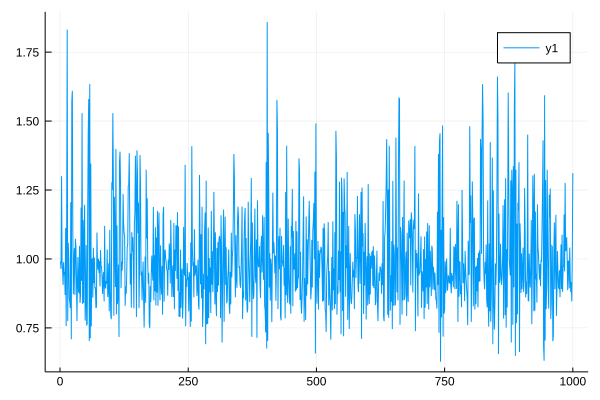

In [30]:
ampl_data = chn[:ampl].value.data
print(mean(ampl_data[:,1,1]))
plot(ampl_data[:,1,1])

In [34]:
r_data = chn[:r].value.data
r_mean=mean(r_data,dims=1)[1,:,1]

1002-element Array{Real,1}:
  1.1247085453777492  
  0.9401930170787562  
  0.872009942668924   
  0.9792437324585924  
  1.1074281626023823  
  1.1491833580824742  
  1.4751847827639715  
  1.3764656195115066  
  1.1022357861249477  
  0.8835873473296557  
  0.5380927366220556  
  0.8149751790232277  
  1.285398787333094   
  ⋮                   
 -0.6678342089932943  
 -0.008202784205298644
  0.19469890607180104 
 -0.09962950917020552 
  0.21612831384352793 
  0.24733510239204495 
  0.33292086997632586 
  0.9616265111378369  
  1.0343198600184507  
  1.0429872748104427  
  0.9604466986561003  
  0.41846238450208345 

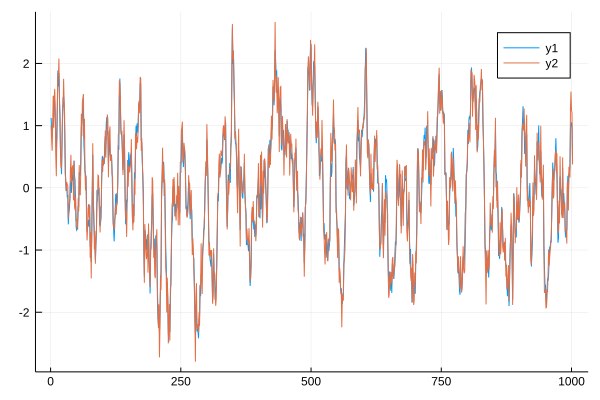

In [39]:
plot(r_mean)
plot!(sol.u)

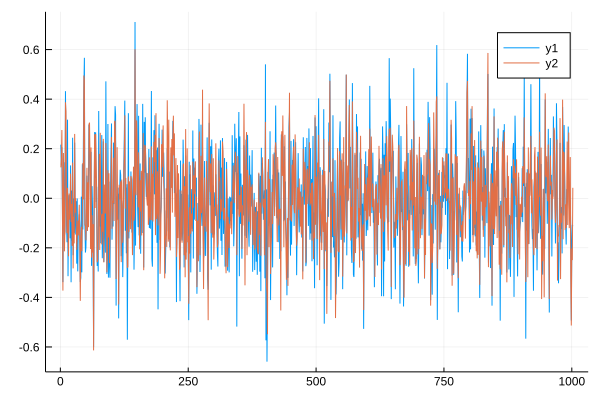

In [40]:
plot(noise)
plot!(r_mean-sol.u)